In [8]:
import sys
sys.path.append("..")

import geopandas as gp
import src.config
from src.datasets.loading import statcan

output_name = "LastFourQuartersOrBestEstimate_On_DissolvedSmallerCitiesHexes"
output_dir = src.config.DATA_DIRECTORY / "processed" / "statistical_geometries"
output_dir.mkdir(exist_ok=True)

CRS = 'EPSG:4326'

popctrs = statcan.boundary('population_centres')

speed_data = gp.read_file(output_dir / output_name, driver="MapInfo File")
speed_data.crs = popctrs.crs


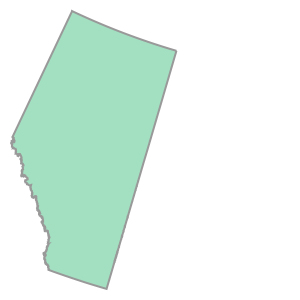

In [9]:
ab_geom = statcan.boundary('provinces').loc[lambda s:s.PRENAME == "Alberta"].geometry.iloc[0]
ab_geom

In [10]:
#'covers', 'touches', 'within', 'overlaps', 'intersects', 'contains_properly', 'contains', None, 'crosses'
ab_speed_data = speed_data.sjoin(statcan.boundary('provinces').loc[lambda s:s.PRENAME == "Alberta"],how='inner', predicate="intersects")
# ab_speed_data = ab_speed_data.sjoint(statcan.boundary('provinces').loc[lambda s:s.PRENAME == "Alberta", 'geometry'], how='inner', predicate="") #intersects is default
# ab_speed_data = statcan.boundary('provinces').loc[lambda s:s.PRENAME == "Alberta"].sjoin(speed_data,how='inner', predicate="contains") #intersects is default

ab_speed_data.loc[:, ['HEXUID_PCPUID','PCNAME','Pop2016','Pop_Avail_50_10','ookla_50_10_percentile']]

,HEXUID_PCPUID,PCNAME,Pop2016,Pop_Avail_50_10,ookla_50_10_percentile
623,AB53391134-480252,Edmonton,1139.244958,91.988502,97.222222
624,AB53671135-480252,Edmonton,154.823529,0.000000,94.117647
625,AB53651135-480252,Edmonton,33529.033113,97.530337,98.871332
626,AB53391135-480252,Edmonton,15362.783164,99.856124,97.607656
627,AB53421133-480252,Edmonton,337.454545,100.000000,100.000000
...,...,...,...,...,...
61446,BC55711200,,72.620426,0.000000,16.666667
61452,BC56011200,,23.428571,0.000000,0.000000
61456,BC56191200,,27.987342,0.000000,0.000000
61458,BC56311200,,9.325758,0.000000,0.000000


In [11]:
statcan.boundary("census_divisions")[['PRNAME','CDNAME']].value_counts()

PRNAME                                               CDNAME               
Alberta                                              Division No.  1          1
Quebec / Québec                                      Beauharnois-Salaberry    1
                                                     L'Islet                  1
                                                     L'Assomption             1
                                                     Kamouraska               1
                                                                             ..
Northwest Territories / Territoires du Nord-Ouest    Region 1                 1
Newfoundland and Labrador / Terre-Neuve-et-Labrador  Division No. 11          1
                                                     Division No. 10          1
                                                     Division No.  9          1
Yukon                                                Yukon                    1
Length: 293, dtype: int64

In [12]:
statcan.boundary('provinces').loc[lambda s:s.PRENAME == "Alberta"]

,PRUID,PRNAME,PRENAME,PRFNAME,PREABBR,PRFABBR,geometry
8,48,Alberta,Alberta,Alberta,Alta.,Alb.,"POLYGON ((5228304.177 2767597.891, 5228098.463..."


In [ ]:
statcan.boundary('economic_regions').loc[lambda s:(s.PRNAME=="Saskatchewan") & (s.ERNAME == "Regina--Moose Mountain")]

,ERUID,ERNAME,PRUID,PRNAME,geometry
51,4710,Regina--Moose Mountain,47,Saskatchewan,"POLYGON ((5253247.371 1763719.194, 5253324.311..."


In [ ]:
ab_speed_data.columns

Index(['PCPUID', 'HEXUID_PCPUID', 'PCNAME', 'PCCLASS', 'Pop2016',
       'TDwell2016_TLog2016', 'URDwell2016_RH2016', 'PHH_Count', 'Common_Type',
       'Pop2016_at_50_10_Combined', 'TDwell2016_at_50_10_Combined',
       'URDwell_at_50_10_Combined', 'Pop_Avail_50_10', 'TDwell_Avail_50_10',
       'URDwell_Avail_50_10', 'avg_d_kbps', 'std_d_kbps', 'min_d_kbps',
       'P25_d_kbps', 'P50_d_kbps', 'P75_d_kbps', 'max_d_kbps', 'avg_u_kbps',
       'std_u_kbps', 'min_u_kbps', 'P25_u_kbps', 'P50_u_kbps', 'P75_u_kbps',
       'max_u_kbps', 'avg_lat_ms', 'tests', 'ave_tests_per_tile',
       'unique_devices', 'ave_devices_per_tile', 'num_tiles',
       'Down_50_percentile', 'Up_10_percentile', 'ookla_50_10_percentile',
       'min_year', 'max_year', 'connections', 'geometry', 'index_right',
       'PRUID', 'PRNAME', 'PRENAME', 'PRFNAME', 'PREABBR', 'PRFABBR'],
      dtype='object')

In [17]:
ab_speed_data[["Pop2016","Pop_Avail_50_10","Pop2016_at_50_10_Combined","ookla_50_10_percentile"]]

,Pop2016,Pop_Avail_50_10,Pop2016_at_50_10_Combined,ookla_50_10_percentile
623,1139.244958,91.988502,1047.974370,97.222222
624,154.823529,0.000000,0.000000,94.117647
625,33529.033113,97.530337,32700.979076,98.871332
626,15362.783164,99.856124,15340.679825,97.607656
627,337.454545,100.000000,337.454545,100.000000
...,...,...,...,...
61446,72.620426,0.000000,0.000000,16.666667
61452,23.428571,0.000000,0.000000,0.000000
61456,27.987342,0.000000,0.000000,0.000000
61458,9.325758,0.000000,0.000000,0.000000


In [15]:
ab_speed_data.groupby('PCCLASS')[["Pop2016","Pop_Avail_50_10","ookla_50_10_percentile"]].sum()
ab_speed_data.groupby('PCCLASS')[["Pop2016","Pop_Avail_50_10","ookla_50_10_percentile"]].sum()

,Pop2016,Pop_Avail_50_10,ookla_50_10_percentile
PCCLASS,,,
,6.717357e+05,167881.892579,146641.318761
2,6.030927e+05,9862.738617,7483.486978
3,5.077379e+05,895.724510,786.349823
4,2.300289e+06,7251.156145,7067.471078


In [25]:
econ_join = speed_data.sjoin(statcan.boundary('economic_regions'), how='inner')
econ_join

,PCPUID,HEXUID_PCPUID,PCNAME,PCCLASS,Pop2016,TDwell2016_TLog2016,URDwell2016_RH2016,PHH_Count,Common_Type,Pop2016_at_50_10_Combined,...,ookla_50_10_percentile,min_year,max_year,connections,geometry,index_right,ERUID,ERNAME,PRUID,PRNAME
0,100792,NL47580528-100792,St. John's,4,9896.147562,5058.332094,4318.056742,685.0,3.0,9860.925340,...,89.552239,Q4 2021,Q3 2022,{'fixed'},"MULTIPOLYGON (((8975148.890 2149398.720, 89753...",0,1010,Avalon Peninsula,10,Newfoundland and Labrador / Terre-Neuve-et-Lab...
1,100792,NL47580529-100792,St. John's,4,4252.819048,1648.265873,1558.259524,437.0,4.0,4252.819048,...,92.222222,Q4 2021,Q3 2022,{'fixed'},"POLYGON ((8967674.390 2143964.420, 8967679.040...",0,1010,Avalon Peninsula,10,Newfoundland and Labrador / Terre-Neuve-et-Lab...
2,100792,NL47710527-100792,St. John's,4,0.000000,0.000000,0.000000,0.0,0.0,0.000000,...,33.333333,Q1 2022,Q3 2022,{'fixed'},"POLYGON ((8971687.220 2162844.840, 8971644.650...",0,1010,Avalon Peninsula,10,Newfoundland and Labrador / Terre-Neuve-et-Lab...
3,100792,NL47430528-100792,St. John's,4,2662.527342,1056.284918,1025.692964,149.0,3.0,2662.527342,...,100.000000,Q4 2021,Q3 2022,{'fixed'},"POLYGON ((8983681.010 2140410.870, 8983745.480...",0,1010,Avalon Peninsula,10,Newfoundland and Labrador / Terre-Neuve-et-Lab...
4,100792,NL47510528-100792,St. John's,4,24029.650382,10449.110393,9692.839561,1684.0,3.0,24029.650382,...,93.956044,Q4 2021,Q3 2022,{'fixed'},"POLYGON ((8979409.310 2142110.790, 8979381.260...",0,1010,Avalon Peninsula,10,Newfoundland and Labrador / Terre-Neuve-et-Lab...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13349,,NU63700686,,,10.153846,5.230769,4.307692,5.0,3.0,0.000000,...,25.000000,Q3 2021,Q3 2022,{'fixed'},"POLYGON ((7294412.390 3237084.530, 7295009.180...",75,6210,Nunavut,62,Nunavut
13350,,NU69500936,,,302.000000,74.000000,67.000000,1.0,1.0,0.000000,...,0.000000,No Data,No Data,nan,"POLYGON ((6136564.100 3662093.700, 6135664.220...",75,6210,Nunavut,62,Nunavut
13352,,NU73000852,,,278.393939,70.848485,68.075758,29.0,5.0,0.000000,...,0.000000,No Data,No Data,nan,"POLYGON ((6414878.360 4054652.160, 6414909.020...",75,6210,Nunavut,62,Nunavut
13353,,NU54020790,,,0.000000,0.000000,0.000000,0.0,0.0,0.000000,...,0.000000,Q2 2022,Q2 2022,{'fixed'},"MULTIPOLYGON (((7018658.450 2065348.560, 70219...",75,6210,Nunavut,62,Nunavut


In [23]:
import branca.colormap as cm

map = ab_speed_data.loc[lambda s:s.Pop2016 >0.0].explore(
    'ookla_50_10_percentile',#scheme='equalinterval', k = 4, 
    cmap=cm.StepColormap(['gray','red','orange','yellow','blue'], vmin=0, vmax=100, index=[0,1,25,50,75,100]),
    tooltip=['HEXUID_PCPUID','PCNAME','Pop2016','Pop_Avail_50_10','ookla_50_10_percentile'],
    popup=[
        'HEXUID_PCPUID','PCNAME',
        'min_d_kbps','avg_d_kbps','max_d_kbps',
        'min_u_kbps','avg_u_kbps','max_u_kbps',
        'Pop2016','tests','num_tiles','unique_devices', 'min_year','max_year','connections',
        'Pop_Avail_50_10','ookla_50_10_percentile','Down_50_percentile','Up_10_percentile']
)
map

In [58]:
from OSMPythonTools.nominatim import Nominatim
nom = Nominatim()
result = nom.query("Edmonton").toJSON()

[nominatim] downloading data: search


In [59]:
coord = result[0]['lat'], result[0]['lon']
wkt_coord = f'POINT ({coord[0]} {coord[1]})'
wkt_coord

'POINT (53.5462055 -113.491241)'

In [62]:
result

[{'place_id': 298643052,
  'licence': 'Data © OpenStreetMap contributors, ODbL 1.0. https://osm.org/copyright',
  'osm_type': 'relation',
  'osm_id': 2564500,
  'boundingbox': ['53.3372558', '53.7162646', '-113.7138411', '-113.2714783'],
  'lat': '53.5462055',
  'lon': '-113.491241',
  'display_name': 'Edmonton, Alberta, Canada',
  'class': 'place',
  'type': 'city',
  'importance': 0.7408839447495602,
  'icon': 'https://nominatim.openstreetmap.org/ui/mapicons/poi_place_city.p.20.png'},
 {'place_id': 122111,
  'licence': 'Data © OpenStreetMap contributors, ODbL 1.0. https://osm.org/copyright',
  'osm_type': 'node',
  'osm_id': 27365051,
  'boundingbox': ['51.6067968', '51.6467968', '-0.0969118', '-0.0569118'],
  'lat': '51.6267968',
  'lon': '-0.0769118',
  'display_name': 'Edmonton, London Borough of Enfield, London, Greater London, England, N9 9HH, United Kingdom',
  'class': 'place',
  'type': 'suburb',
  'importance': 0.5543289379070789,
  'icon': 'https://nominatim.openstreetmap.o

In [56]:
geom = gp.points_from_xy(y=[coord[0]], x=[coord[1]])
result_data = gp.GeoDataFrame(result, geometry=geom, crs="EPSG:4326")
result_data = result_data.to_crs(speed_data.crs)
result_data

,place_id,licence,osm_type,osm_id,boundingbox,lat,lon,display_name,class,type,importance,geometry
0,278668812,"Data © OpenStreetMap contributors, ODbL 1.0. h...",way,925372224,"[51.0373279, 51.0374529, -114.1021992, -114.10...",51.0373905,-114.10202519690444,"Villa Calamo, 1809, 17 Street SW, Bankview, Ca...",building,apartments,0.4101,POINT (4683258.735 1922592.359)


In [57]:
result_data.sjoin(speed_data)

,place_id,licence,osm_type,osm_id,boundingbox,lat,lon,display_name,class,type,...,ave_tests_per_tile,unique_devices,ave_devices_per_tile,num_tiles,Down_50_percentile,Up_10_percentile,ookla_50_10_percentile,min_year,max_year,connections
0,278668812,"Data © OpenStreetMap contributors, ODbL 1.0. h...",way,925372224,"[51.0373279, 51.0374529, -114.1021992, -114.10...",51.0373905,-114.10202519690444,"Villa Calamo, 1809, 17 Street SW, Bankview, Ca...",building,apartments,...,36.141289,8148.0,11.176955,729.0,97.39369,98.765432,97.39369,Q4 2021,Q3 2022,{'fixed'}


In [73]:
import pandas as pd

In [78]:
nominatim = Nominatim()

def lookup_address(address):
    results = nominatim.query(address).toJSON()
    return results


def address_speeds(results):
    result = results[0]
    # print(result)
    coord = result['lat'], result['lon']
    geom = gp.points_from_xy(y=[coord[0]], x=[coord[1]])
    result_data = gp.GeoDataFrame(results[0:1], geometry=geom, crs="EPSG:4326")
    
    result_data = result_data.to_crs(speed_data.crs)
    
    speed = result_data.sjoin(speed_data)
    return speed

In [65]:
r = lookup_address('Edmonton')

In [79]:
address_speeds(r)

12
<GeometryArray>
Length: 1, dtype: geometry
    place_id                                            licence  osm_type  \
0  298643052  Data © OpenStreetMap contributors, ODbL 1.0. h...  relation   
1  298643052  Data © OpenStreetMap contributors, ODbL 1.0. h...  relation   
2  298643052  Data © OpenStreetMap contributors, ODbL 1.0. h...  relation   
3  298643052  Data © OpenStreetMap contributors, ODbL 1.0. h...  relation   

    osm_id   boundingbox         lat          lon               display_name  \
0  2564500    53.3372558  53.5462055  -113.491241  Edmonton, Alberta, Canada   
1  2564500    53.7162646  53.5462055  -113.491241  Edmonton, Alberta, Canada   
2  2564500  -113.7138411  53.5462055  -113.491241  Edmonton, Alberta, Canada   
3  2564500  -113.2714783  53.5462055  -113.491241  Edmonton, Alberta, Canada   

   class  type  importance                                               icon  
0  place  city    0.740884  https://nominatim.openstreetmap.org/ui/mapicon...  
1  plac

,place_id,licence,osm_type,osm_id,boundingbox,lat,lon,display_name,class,type,...,ave_tests_per_tile,unique_devices,ave_devices_per_tile,num_tiles,Down_50_percentile,Up_10_percentile,ookla_50_10_percentile,min_year,max_year,connections
0,298643052,"Data © OpenStreetMap contributors, ODbL 1.0. h...",relation,2564500,"[53.3372558, 53.7162646, -113.7138411, -113.27...",53.5462055,-113.491241,"Edmonton, Alberta, Canada",place,city,...,20.181258,6543.0,8.067818,811.0,96.177559,98.397041,96.177559,Q4 2021,Q3 2022,{'fixed'}
